In [39]:
import scipy.io
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
from matplotlib.animation import FuncAnimation
from matplotlib.animation import PillowWriter
from IPython.display import Image
import scipy.io as sp
from networkx.algorithms.community import greedy_modularity_communities


In [40]:
path = r"/Users/sabrina/Documents/UNI/A-NEUROCIENCIAS/QUINTO /MODELOS/Neurociencias-2025-1/BCT/BCT/2019_03_03_BCT/data_and_demos/Coactivation_matrix.mat"
data = scipy.io.loadmat(path)
print(data)

{'__header__': b'MATLAB 5.0 MAT-file, Platform: GLNX86, Created on: Wed Dec 25 01:14:03 2013', '__version__': '1.0', '__globals__': [], 'Coactivation_matrix': array([[0.        , 0.16071429, 0.11148649, ..., 0.        , 0.05045872,
        0.1011236 ],
       [0.16071429, 0.        , 0.06825939, ..., 0.        , 0.        ,
        0.06923077],
       [0.11148649, 0.06825939, 0.        , ..., 0.03412969, 0.        ,
        0.        ],
       ...,
       [0.        , 0.        , 0.03412969, ..., 0.        , 0.        ,
        0.        ],
       [0.05045872, 0.        , 0.        , ..., 0.        , 0.        ,
        0.09777778],
       [0.1011236 , 0.06923077, 0.        , ..., 0.        , 0.09777778,
        0.        ]]), 'Coord': array([[ 7.24363636, 37.01090909,  9.42545455],
       [ 7.98653199, 46.22222222, 15.60942761],
       [ 7.55725191, 33.83206107, 23.51145038],
       ...,
       [-4.92385787, 15.31979695, 27.73604061],
       [-6.27312775, 34.70484581, -5.09251101],
  

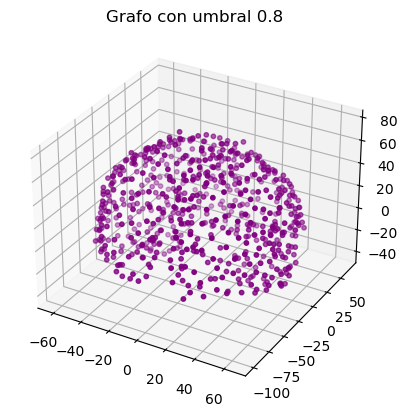

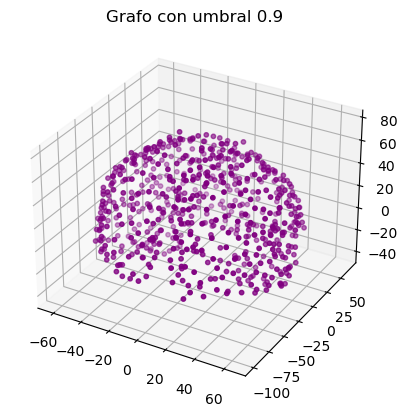

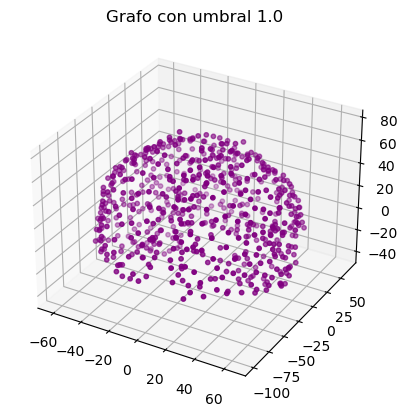

In [70]:
# 1) Definir grafos con la matriz estableciendo umbrales de coactivación de 0.8, 0.9 y 1 y graficar cada grafo. Añadir las coordenadas tridimensionales (incluidas en el archivo .mat).

matrix = data['Coactivation_matrix']
coords = data['Coord']

def grafos(matrix, coords, umbral):
    adj_matrix = (matrix >= umbral).astype(int) # crear matriz dependiendo del umbral 
    grafo = nx.from_numpy_array(adj_matrix)
    
    pos = {i: coords[i] for i in range(len(coords))} # para verlo 3D 
    
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    for edge in grafo.edges():
        x = [pos[edge[0]][0], pos[edge[1]][0]]
        y = [pos[edge[0]][1], pos[edge[1]][1]]
        z = [pos[edge[0]][2], pos[edge[1]][2]]
        ax.plot(x, y, z, color='b', alpha=0.5)
    ax.scatter(coords[:, 0], coords[:, 1], coords[:, 2], color='purple', s=10)
    ax.set_title(f'Grafo con umbral {umbral}')
    plt.show()
    
for umbral in [0.8, 0.9, 1.0]:
    grafos(matrix, coords, umbral)

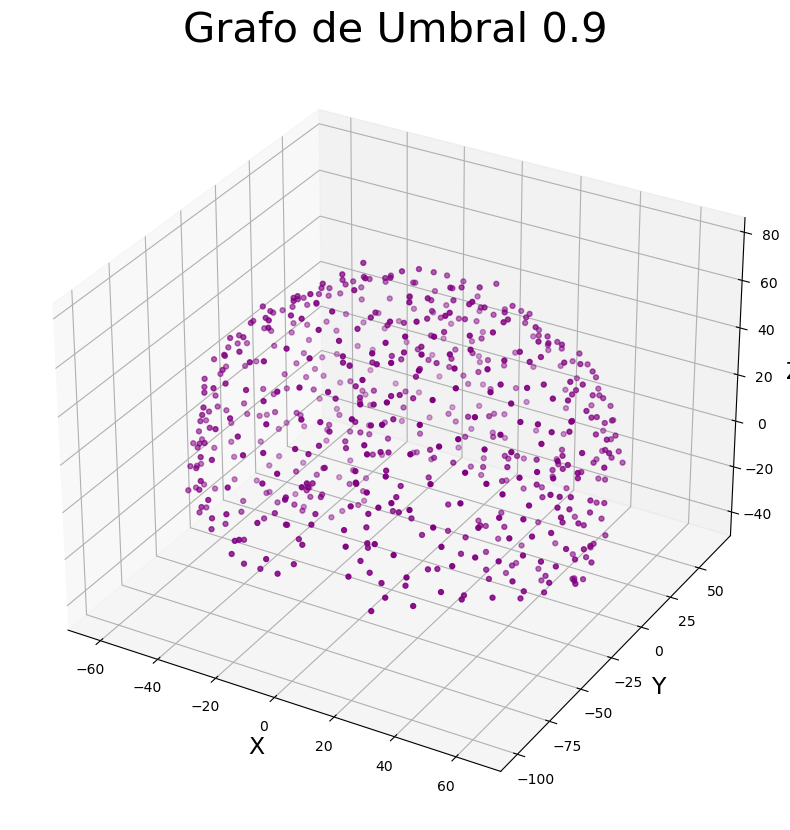

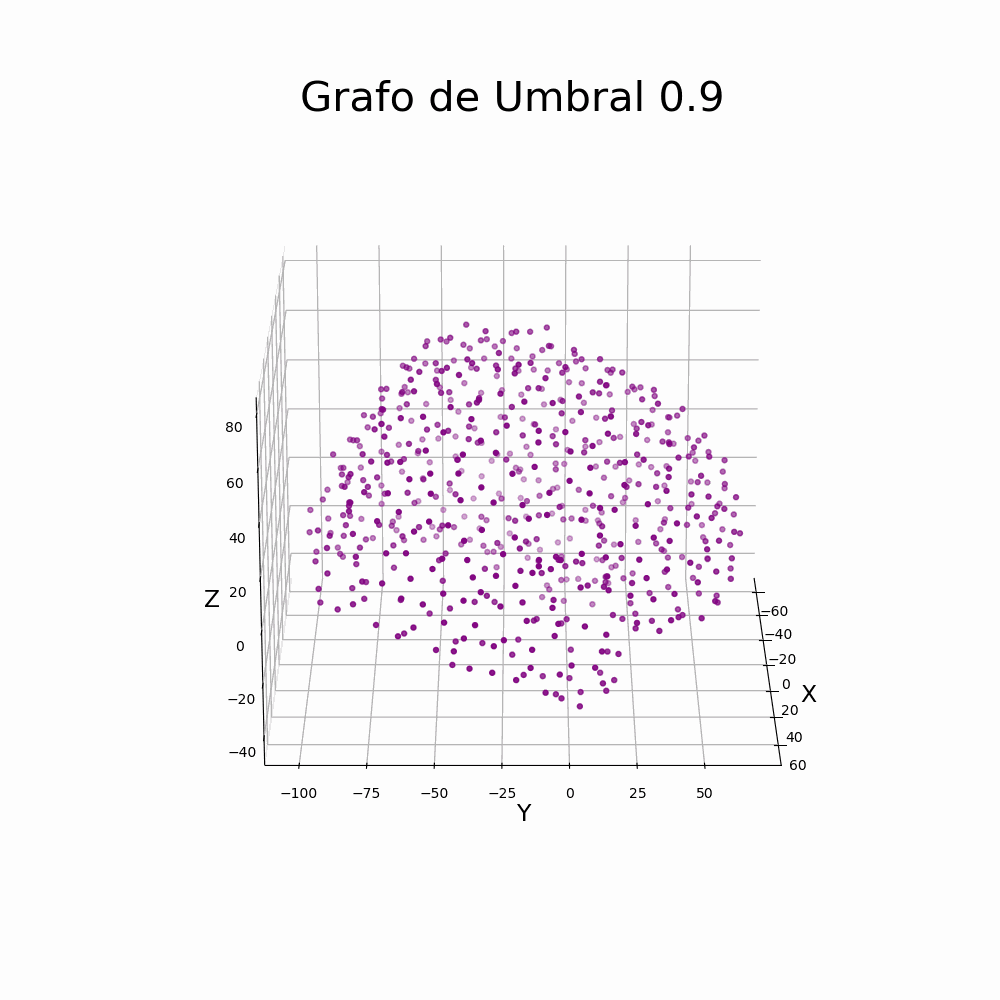

In [28]:
# 2) Con uno de los grafos en el punto uno con umbral 0.9, generar una animación donde se haga girar 360° el grafo del cerebro para visualizar las conexiones establecidas.
matrix = data['Coactivation_matrix']
coords = data['Coord']
x, y, z = coords[:, 0], coords[:, 1], coords[:, 2]

# Umbral de 0.9
umbral = 0.9
adj_mat_nueve = (matrix >= umbral).astype(int)  # Filtrado por el umbral
grafo_nueve = nx.from_numpy_array(adj_mat_nueve)  # Crear el grafo

fig_grafo_nueve = plt.figure(figsize=(10, 10))
ax = fig_grafo_nueve.add_subplot(projection='3d')
ax.scatter(x, y, z, c='purple', s=50, marker='.')

for edge in grafo_nueve.edges():
    node1, node2 = edge
    x_coords = [x[node1], x[node2]]
    y_coords = [y[node1], y[node2]]
    z_coords = [z[node1], z[node2]]
    ax.plot(x_coords, y_coords, z_coords, c='purple', alpha=0.5)

ax.set_title(f'Grafo de Umbral 0.9', fontsize=30)
ax.set_xlabel('X', fontsize=17)
ax.set_ylabel('Y', fontsize=17)
ax.set_zlabel('Z', fontsize=17)

#animacion 
def init():
    ax.view_init(elev=20, azim=0)
    return fig_grafo_nueve,

# rotar
def rotar(frame):
    ax.view_init(elev=20, azim=frame)
    return fig_grafo_nueve,

# Crear la animación
anim_nueve = FuncAnimation(fig_grafo_nueve, rotar, init_func=init, frames=360, interval=50, blit=False)

# ver la animación en Jupyter Notebook
plt.show()

# guardar la animación como GIF
grafo_mov = "grafo_animado_0.9.gif"
anim_nueve.save(grafo_mov, writer=PillowWriter(fps=20))

# mostrar el GIF en Jupyter Notebook
Image("grafo_animado_0.9.gif")

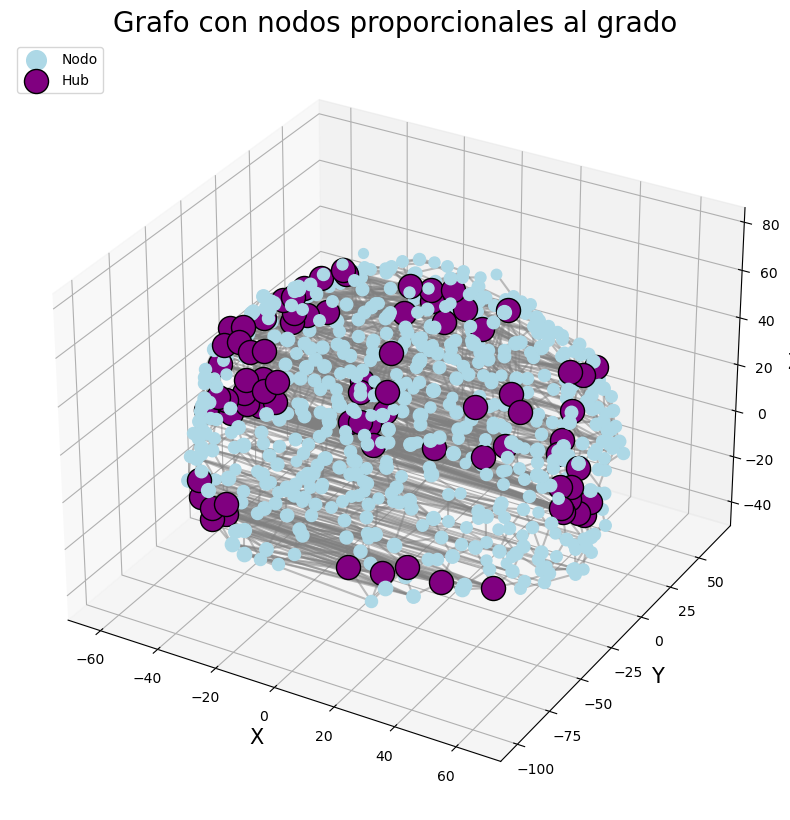

Existen 80 hubs en el grafo:
Los hubs son: [19, 38, 69, 70, 100, 121, 135, 186, 202, 213, 230, 235, 237, 253, 261, 262, 266, 267, 271, 279, 285, 308, 309, 327, 328, 330, 331, 334, 344, 345, 346, 350, 352, 353, 356, 361, 362, 373, 393, 397, 400, 403, 407, 410, 416, 418, 452, 453, 454, 457, 465, 473, 477, 481, 482, 485, 488, 491, 494, 496, 500, 532, 552, 553, 599, 601, 603, 606, 607, 611, 612, 613, 615, 616, 617, 618, 619, 621, 622, 629]
El umbral para ser considerado un hub es un grado de al menos 10.00.


In [36]:
# 3) Encontrar los hubs del grafo, y establecer el tamaño del nodo proporcional al valor del grado.

coactivation_matrix = mat["Coactivation_matrix"]
coordinates = mat["Coord"]
x, y, z = coordinates[:, 0], coordinates[:, 1], coordinates[:, 2]

threshold = 0.09
adj_mat_nueve = (coactivation_matrix >= threshold).astype(int)

G = nx.from_numpy_array(adj_mat_nueve)

# grado de los nodos y tamaño
degrees = dict(G.degree())
degree_val = list(degrees.values())
max_degree = max(degree_val)
min_degree = min(degree_val)

node_sizes = [
    50 + (200 - 50) * (degree - min_degree) / (max_degree - min_degree)
    for degree in degree_val
]

# figura
fig_nueve = plt.figure(figsize=(10, 10))
ax = fig_nueve.add_subplot(111, projection="3d")

# nodo proporcionales al grado 
for node, size in zip(G.nodes(), node_sizes):
    ax.scatter(
        x[node], y[node], z[node],
        c="lightblue", s=size, label="Nodo" if size == max(node_sizes) else ""
    )

# aristas
for edge in G.edges():
    node1, node2 = edge
    x_coords = [x[node1], x[node2]]
    y_coords = [y[node1], y[node2]]
    z_coords = [z[node1], z[node2]]
    ax.plot(x_coords, y_coords, z_coords, c="gray", alpha=0.5)

# identificar los hubs
# XQ THREHOLD = 90?
# hub = grado arriba de media +una desviación estandar
hub_threshold = np.percentile(degree_val, 90)  # usamos el percentil 90 para definir los hubs
hubs = [node for node, degree in degrees.items() if degree >= hub_threshold]

# resaltar los hubs 
for hub in hubs:
    ax.scatter(
        x[hub], y[hub], z[hub],
        c="purple", s=300, edgecolors="black", label="Hub" if hub == hubs[0] else ""
    )

ax.set_title("Grafo con nodos proporcionales al grado", fontsize=20)
ax.set_xlabel("X", fontsize=15)
ax.set_ylabel("Y", fontsize=15)
ax.set_zlabel("Z", fontsize=15)
ax.legend(loc="upper left")

plt.show()

# Imprimir resultados de los hubs
print(f"Existen {len(hubs)} hubs en el grafo:")
print(f"Estos hubs son: {hubs}")
print(f"El umbral para ser considerado un hub es un grado de al menos {hub_threshold:.2f}.")


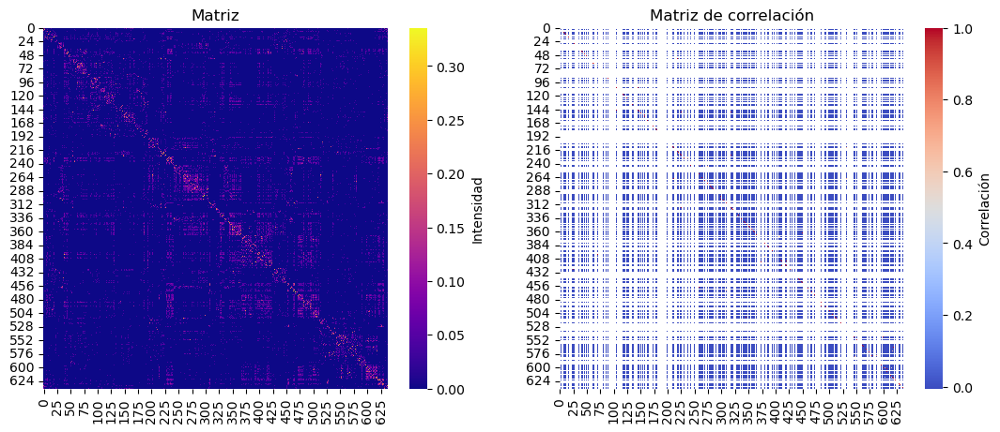

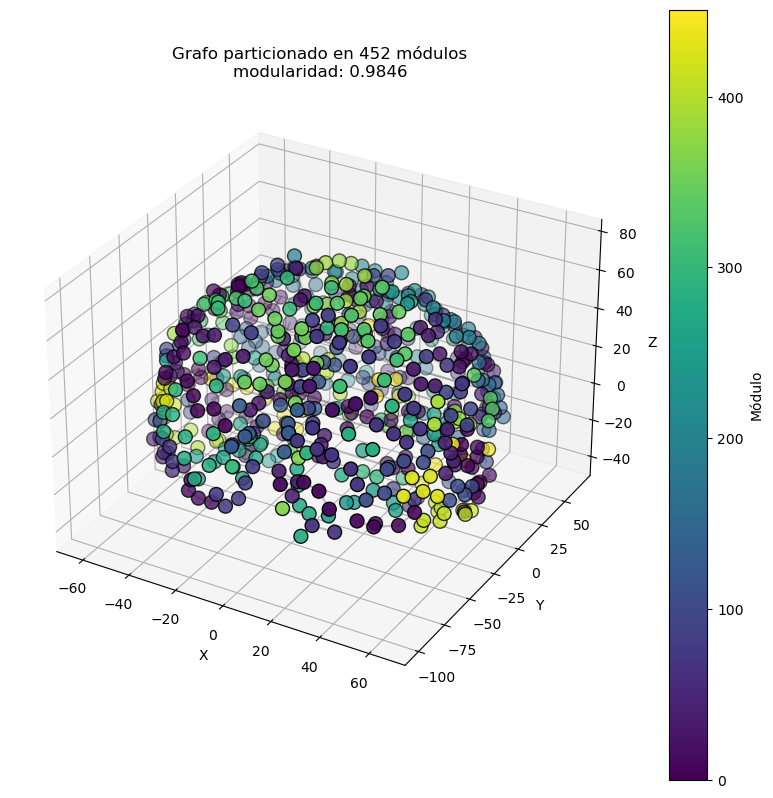

Identificamos 452 módulos.
La modularidad obtenida es de 0.9846. Se seleccionó a partir del algoritmo de modularidad que maximiza la cohesión interna dentro de cada comunidad. Este número sugiere que la partición es de buena calidad, optimizando las conexiones dentro de cada módulo y separando las comunidades de forma eficiente. Escogí este número de módulos por el umbral tan bajo, produciendo una red dispersa con muchas comunidades


In [42]:
# 4) En función de la matriz de emparejamiento (correlación de la matriz de adyacencia), establecer una partición de los nodos en módulos. Escoger el número de módulos que creas conveniente y justificar por qué escogiste ese número.
coact_mat = data['Coactivation_matrix']
coords = data['Coord']
x, y, z = coords[:, 0], coords[:, 1], coords[:, 2]

threshold = 0.2
adj_mat = np.where(coact_matrix >= threshold, coact_matrix, 0)
correlation_matrix = np.corrcoef(adj_mat)

plt.figure(figsize=(13, 5))
plt.subplot(1, 2, 1)
sns.heatmap(coact_mat, cmap="plasma", cbar_kws={"label": "Intensidad"})
plt.title("Matriz")
plt.subplot(1, 2, 2)
sns.heatmap(correlation_matrix, cmap="coolwarm", cbar_kws={"label": "Correlación"})
plt.title("Matriz de correlación")
plt.show()

G = nx.from_numpy_array(adj_mat)

# modulos a partir del algoritmo de modularidad 
# EXCELENTE!!!!
communities = list(greedy_modularity_communities(G))

# colorear modulos
partition = {}
for i, community in enumerate(communities):
    for node in community:
        partition[node] = i

modularity = nx.algorithms.community.quality.modularity(G, communities)
node_colors = [partition[node] for node in G.nodes()]

fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111, projection="3d")

scatter = ax.scatter(
    x, y, z, c=node_colors, cmap="viridis", s=100, edgecolors="black", label="Nodos"
)

for edge in G.edges():
    node1, node2 = edge
    x_edge = [x[node1], x[node2]]
    y_edge = [y[node1], y[node2]]
    z_edge = [z[node1], z[node2]]
    ax.plot(x_edge, y_edge, z_edge, c="gray", alpha=0.5)

ax.set_title(f"Grafo particionado en {len(communities)} módulos\nmodularidad: {modularity:.4f}")
ax.set_xlabel("X")
ax.set_ylabel("Y")
ax.set_zlabel("Z")
plt.colorbar(scatter, ax=ax, label="Módulo")
plt.show()

# Justificación!!
print(f"Identificamos {len(communities)} módulos.")
print(f"La modularidad obtenida es de {modularity:.4f}. Se seleccionó a partir del algoritmo de modularidad que maximiza la cohesión interna dentro de cada comunidad. Este número sugiere que la partición es de buena calidad, optimizando las conexiones dentro de cada módulo y separando las comunidades de forma eficiente. Escogí este número de módulos por el umbral tan bajo, produciendo una red dispersa con muchas comunidades")

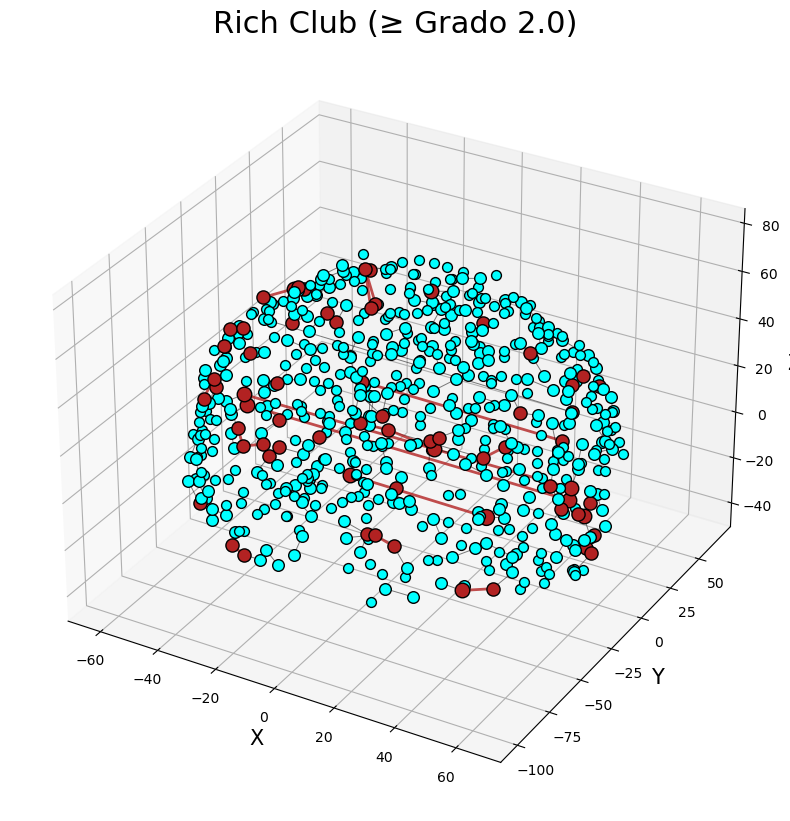

Rich Club en color vino (grado ≥ 2.0): [38, 42, 62, 69, 92, 124, 150, 217, 221, 223, 226, 230, 235, 245, 259, 260, 263, 275, 281, 290, 292, 296, 304, 309, 319, 320, 321, 327, 330, 331, 344, 352, 356, 358, 369, 393, 404, 407, 408, 416, 419, 428, 456, 460, 465, 482, 532, 547, 561, 565, 574, 579, 599, 603, 604, 605, 611, 613, 614, 615, 616, 617, 618, 622, 623, 628, 629]

El Rich Club es un conjunto de nodos altamente conectados dentro de la red, definidos por un umbral de 2.0 (al menos en este caso). 
Identificamos las áreas con una conectividad superior representando las regiones más centrales de la red.
Estas áreas son relevantes para la integración de información en el sistema, como se observa en redes cerebrales, donde los nodos del 
Rich Club tienden a ser estructuras clave para procesos cognitivos avanzados.

El umbral elegido asegura que estemos considerando los nodos más conectados, optimizando así la cohesión interna de la red. 
La modularidad de la red también respalda esta elec

In [48]:
# 5) Determinar el conjunto del Rich Club y discutir las implicaciones anatómicas y funcionales de este grupo de nodos (mínimo 100 palabras).
grado = dict(G.degree())

# Establecer el umbral para el Rich Club (percentil 90)
grado_umbral = np.percentile(list(grado.values()), 90)
rich_club = [nodo for nodo, grado in grado.items() if grado >= grado_umbral]

# Visualizaremos ahora el Rich Club en 3D wow
figura = plt.figure(figsize=(10, 10))
Ax = figura.add_subplot(projection="3d")

for nodo in grado.keys():
    valor = grado[nodo]
    tamaño = 50 + valor * 20 
    color = "firebrick" if nodo in rich_club else "cyan"
    Ax.scatter(x[nodo], y[nodo], z[nodo], color=color, s=tamaño, edgecolors="black")

# Dibujamos aristas
for edge in G.edges():
    node1, node2 = edge
    x_coords = [x[node1], x[node2]]
    y_coords = [y[node1], y[node2]]
    z_coords = [z[node1], z[node2]]
    if node1 in rich_club and node2 in rich_club:
        Ax.plot(x_coords, y_coords, z_coords, c="firebrick", alpha=0.8, linewidth=2)
    else:
        Ax.plot(x_coords, y_coords, z_coords, c="black", alpha=0.5, linewidth=0.7)


Ax.set_title(f"Rich Club (≥ Grado {grado_umbral})", fontsize=22)
Ax.set_xlabel("X", fontsize=15)
Ax.set_ylabel("Y", fontsize=15)
Ax.set_zlabel("Z", fontsize=15)
plt.show()

print(f"Rich Club en color vino (grado ≥ {grado_umbral}): {rich_club}")

justificacion = """
El Rich Club es un conjunto de nodos altamente conectados dentro de la red, definidos por un umbral de 2.0 (al menos en este caso). 
Identificamos las áreas con una conectividad superior representando las regiones más centrales de la red.
Estas áreas son relevantes para la integración de información en el sistema, como se observa en redes cerebrales, donde los nodos del 
Rich Club tienden a ser estructuras clave para procesos cognitivos avanzados.

El umbral elegido asegura que estemos considerando los nodos más conectados, optimizando así la cohesión interna de la red. 
La modularidad de la red también respalda esta elección, una mayor modularidad indica una clara división entre las 
comunidades de la red, con los nodos del Rich Club funcionando como centros de integración.
"""

# Mostrar la justificación
print(justificacion)

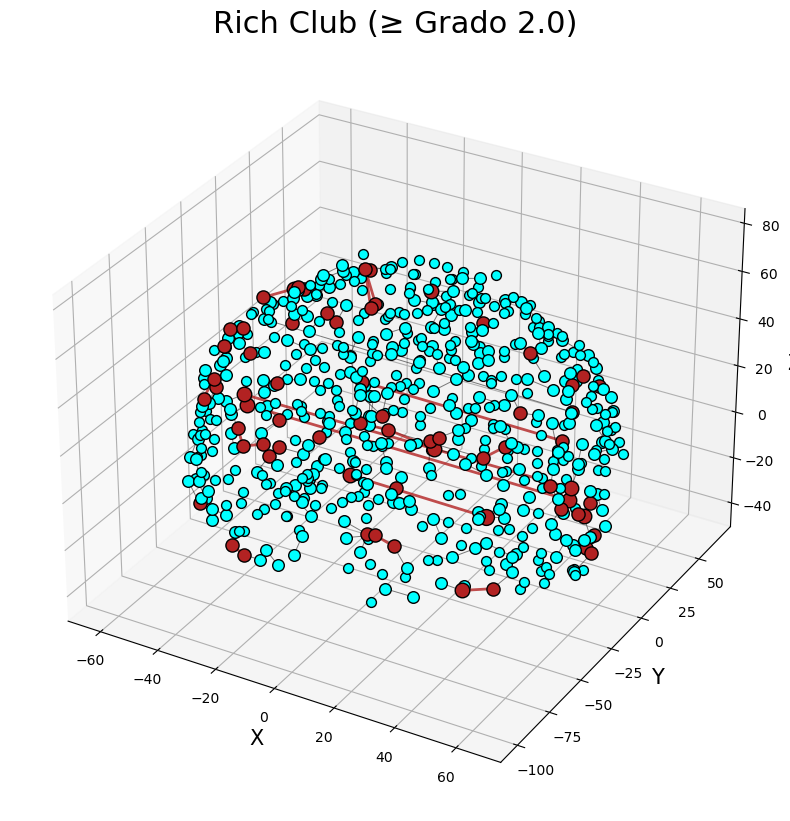

Rich Club en color vino (grado ≥ 2.0): [38, 42, 62, 69, 92, 124, 150, 217, 221, 223, 226, 230, 235, 245, 259, 260, 263, 275, 281, 290, 292, 296, 304, 309, 319, 320, 321, 327, 330, 331, 344, 352, 356, 358, 369, 393, 404, 407, 408, 416, 419, 428, 456, 460, 465, 482, 532, 547, 561, 565, 574, 579, 599, 603, 604, 605, 611, 613, 614, 615, 616, 617, 618, 622, 623, 628, 629]
Propiedades del grafo Original (con Rich Club):
  Número de nodos: 638
  Número de aristas: 188
  Grado promedio: 0.5893416927899686
  Coeficiente de clustering promedio: 0.004702194357366771
  Centralidad de cercanía (promedio): 0.0011233322643708667
  Centralidad de intermediación (promedio): 2.3135769952388597e-06

Propiedades del grafo Sin Rich Club (modificado):
  Número de nodos: 571
  Número de aristas: 73
  Grado promedio: 0.25569176882662
  Coeficiente de clustering promedio: 0.0
  Centralidad de cercanía (promedio): 0.0004485820505730175
  Centralidad de intermediación (promedio): 0.0



In [52]:
# 7) Supongamos que eliminamos los nodos del RichClub, describir cómo cambian las propiedades topológicas del grafo, hacer comparativas del grado, coeficiente de cluster, coeficiente de mundo pequeño y las medidas de centralidad (cercanía, intermediación)

grado = dict(G.degree())
grado_umbral = np.percentile(list(grado.values()), 90)
rich_club = [nodo for nodo, grado in grado.items() if grado >= grado_umbral]

figura = plt.figure(figsize=(10, 10))
Ax = figura.add_subplot(projection="3d")

for nodo in grado.keys():
    valor = grado[nodo]
    tamaño = 50 + valor * 20
    color = "firebrick" if nodo in rich_club else "cyan"
    Ax.scatter(x[nodo], y[nodo], z[nodo], color=color, s=tamaño, edgecolors="black")

for edge in G.edges():
    node1, node2 = edge
    x_coords = [x[node1], x[node2]]
    y_coords = [y[node1], y[node2]]
    z_coords = [z[node1], z[node2]]
    if node1 in rich_club and node2 in rich_club:
        Ax.plot(x_coords, y_coords, z_coords, c="firebrick", alpha=0.8, linewidth=2)
    else:
        Ax.plot(x_coords, y_coords, z_coords, c="black", alpha=0.5, linewidth=0.7)

Ax.set_title(f"Rich Club (≥ Grado {grado_umbral})", fontsize=22)
Ax.set_xlabel("X", fontsize=15)
Ax.set_ylabel("Y", fontsize=15)
Ax.set_zlabel("Z", fontsize=15)
plt.show()

print(f"Rich Club en color vino (grado ≥ {grado_umbral}): {rich_club}")

# eliminar nodos del Rich Club
G_sin_rich_club = G.copy()
G_sin_rich_club.remove_nodes_from(rich_club)


# calcular las propiedades topológicas para el grafo original y modificado
def calcular_propiedades(G, nombre):
    propiedades = {}
    propiedades["Número de nodos"] = G.number_of_nodes()
    propiedades["Número de aristas"] = G.number_of_edges()
    propiedades["Grado promedio"] = sum(dict(G.degree()).values()) / G.number_of_nodes()
    propiedades["Coeficiente de clustering promedio"] = nx.average_clustering(G)
    
    propiedades["Centralidad de cercanía (promedio)"] = np.mean(list(nx.closeness_centrality(G).values()))
    propiedades["Centralidad de intermediación (promedio)"] = np.mean(list(nx.betweenness_centrality(G).values()))
    print(f"Propiedades del grafo {nombre}:")
    for key, value in propiedades.items():
        print(f"  {key}: {value}")
    print()
    return propiedades

propiedades_original = calcular_propiedades(G, 'Original (con Rich Club)')
propiedades_sin_rich_club = calcular_propiedades(G_sin_rich_club, 'Sin Rich Club (modificado)')


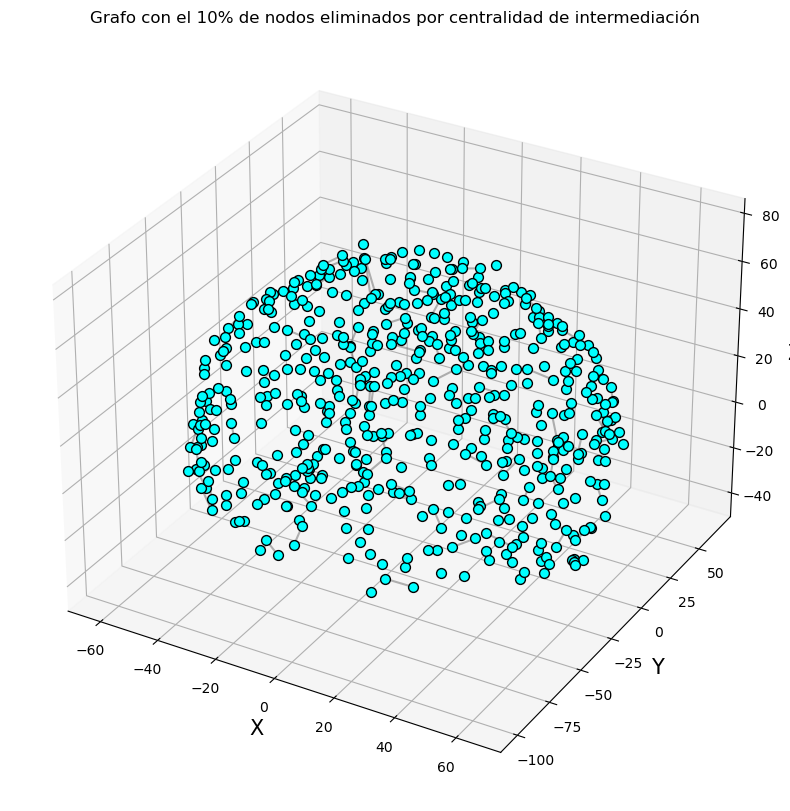

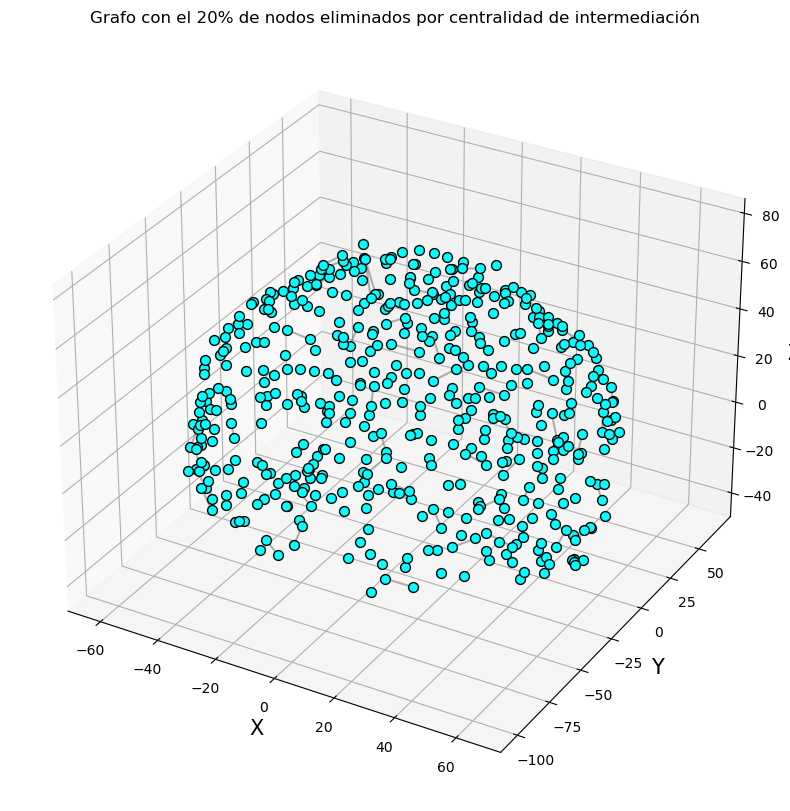

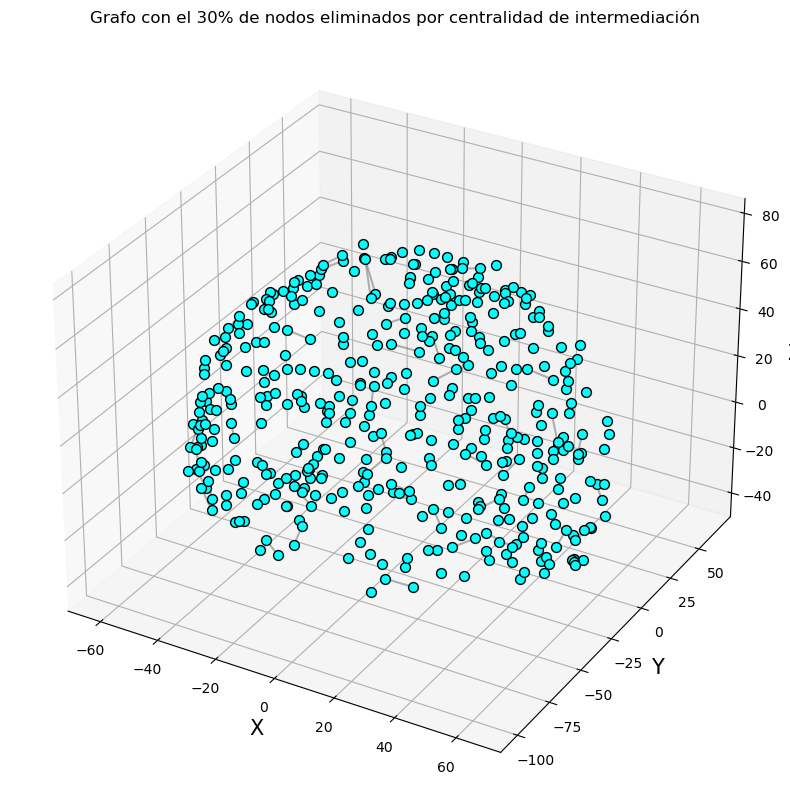

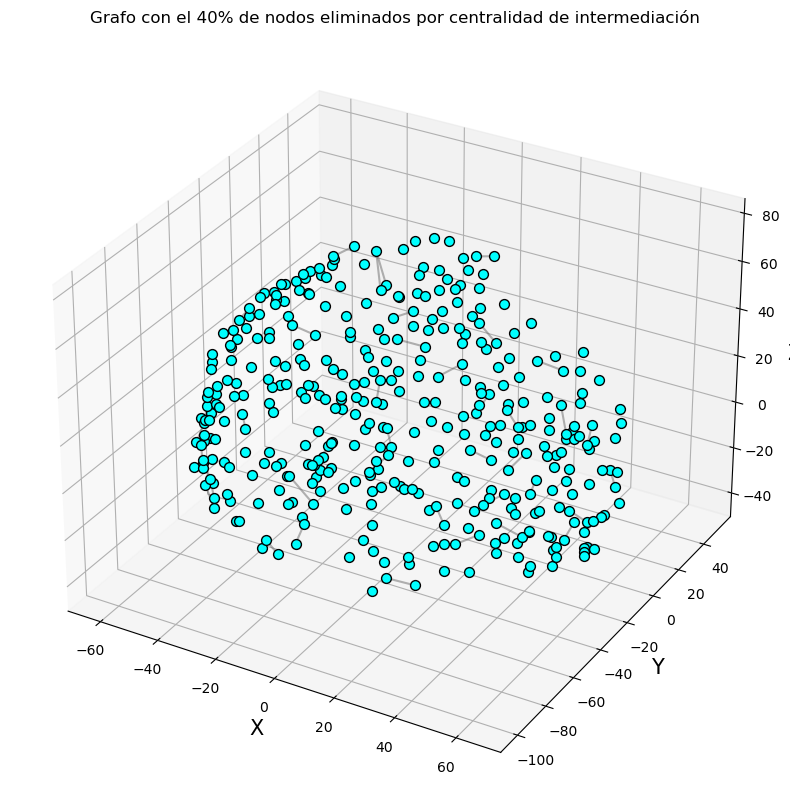

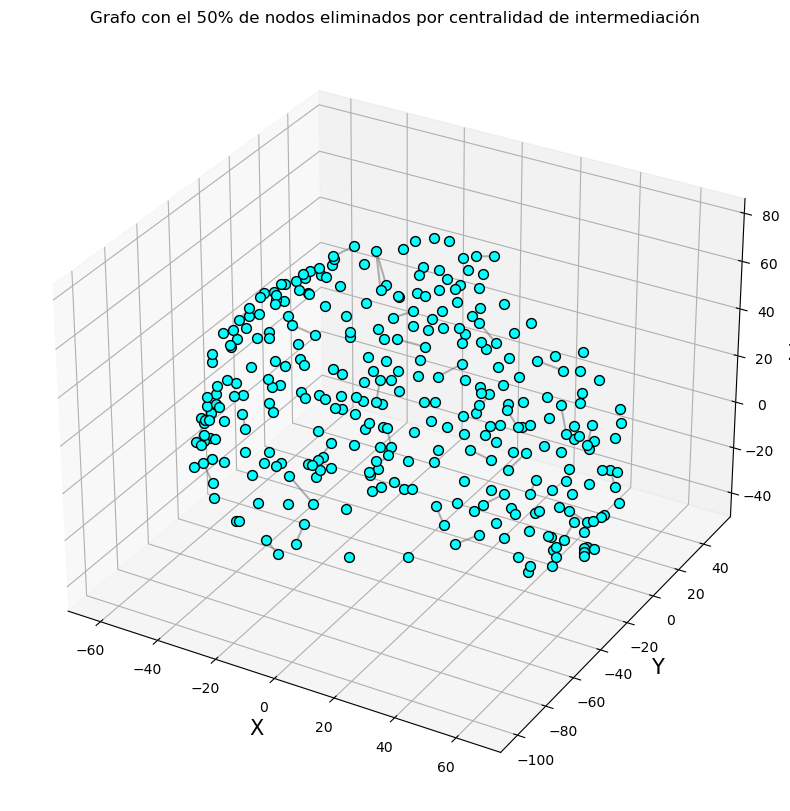

Propiedades del grafo Original:
  Número de nodos: 638
  Número de aristas: 188
  Grado promedio: 0.5893416927899686
  Coeficiente de clustering promedio: 0.004702194357366771
  Coeficiente de mundo pequeño: 0.0012486340776277417
  Centralidad de cercanía promedio: 0.0011233322643708667
  Centralidad de intermediación promedio: 2.3135769952388597e-06

Propiedades del grafo Sin 10% de nodos de alta intermediación:
  Número de nodos: 575
  Número de aristas: 78
  Grado promedio: 0.271304347826087
  Coeficiente de clustering promedio: 0.0052173913043478265
  Coeficiente de mundo pequeño: 0.00047568550219663687
  Centralidad de cercanía promedio: 0.0004746755542089582
  Centralidad de intermediación promedio: 1.0575371598729157e-08

Propiedades del grafo Sin 20% de nodos de alta intermediación:
  Número de nodos: 511
  Número de aristas: 67
  Grado promedio: 0.2622309197651663
  Coeficiente de clustering promedio: 0.005870841487279843
  Coeficiente de mundo pequeño: 0.0005141782740493457
 

In [54]:
# 8) Quitar 10%-50% de los nodos con mayor medida de intermediación y describir cómo cambian las propiedades topológicas del grafo, hacer comparativas del grado, coeficiente de cluster, coeficiente de mundo pequeño y las medidas de centralidad (cercanía, intermediación)

# calcular la centralidad de intermediación de todos los nodos
centralidad_intermediacion = nx.betweenness_centrality(G)

# ordenamos los nodos por centralidad de intermediación
nodos_ordenados = sorted(centralidad_intermediacion.items(), key=lambda x: x[1], reverse=True)

# porcentajes de nodos a eliminar
porcentajes = [0.10, 0.20, 0.30, 0.40, 0.50]

# ver cada porcentaje 
def visualizar_grafo(G, nodos_eliminados, titulo):
    figura = plt.figure(figsize=(10, 10))
    Ax = figura.add_subplot(111, projection='3d')
    
    for nodo in G.nodes():
        Ax.scatter(x[nodo], y[nodo], z[nodo], color='cyan', s=50, edgecolors="black")

    for edge in G.edges():
        node1, node2 = edge
        Ax.plot([x[node1], x[node2]], [y[node1], y[node2]], [z[node1], z[node2]], c='dimgray', alpha=0.5)
    
    Ax.set_title(titulo)
    Ax.set_xlabel("X", fontsize=15)
    Ax.set_ylabel("Y", fontsize=15)
    Ax.set_zlabel("Z", fontsize=15)
    plt.show()

# eliminar nodos y ver los resultados para cada porcentaje
for porcentaje in porcentajes:
    nodos_a_eliminar = [nodo for nodo, _ in nodos_ordenados[:int(len(nodos_ordenados) * porcentaje)]]
    G_modificado = G.copy()
    G_modificado.remove_nodes_from(nodos_a_eliminar)
    titulo = f"Grafo con el {int(porcentaje * 100)}% de nodos eliminados por centralidad de intermediación"
    visualizar_grafo(G_modificado, nodos_a_eliminar, titulo)


# propiedades topológicas
def calcular_propiedades(G, nombre):
    propiedades = {}
    propiedades["Número de nodos"] = G.number_of_nodes()
    propiedades["Número de aristas"] = G.number_of_edges()
    propiedades["Grado promedio"] = sum(dict(G.degree()).values()) / G.number_of_nodes()
    propiedades["Coeficiente de clustering promedio"] = nx.average_clustering(G)
    propiedades["Coeficiente de mundo pequeño"] = nx.global_efficiency(G)
    propiedades["Centralidad de cercanía promedio"] = np.mean(list(nx.closeness_centrality(G).values()))
    propiedades["Centralidad de intermediación promedio"] = np.mean(list(nx.betweenness_centrality(G).values()))
    
    print(f"Propiedades del grafo {nombre}:")
    for key, value in propiedades.items():
        print(f"  {key}: {value}")
    print()
    return propiedades


propiedades_original = calcular_propiedades(G, 'Original')
for porcentaje in porcentajes:
    nodos_a_eliminar = [nodo for nodo, _ in nodos_ordenados[:int(len(nodos_ordenados) * porcentaje)]]
    G_modificado = G.copy()
    G_modificado.remove_nodes_from(nodos_a_eliminar)
    propiedades_modificado = calcular_propiedades(G_modificado, f'Sin {int(porcentaje * 100)}% de nodos de alta intermediación')


Propiedades del grafo Original:
  Número de nodos: 638
  Número de aristas: 18625
  Grado promedio: 58.38557993730407
  Coeficiente de clustering promedio: 0.3844533292242755
  Coeficiente de mundo pequeño: 0.49492420551600974
  Centralidad de cercanía promedio: 0.4547108341582646
  Centralidad de intermediación promedio: 0.0019101789247713589

Propiedades del grafo Modelo Nulo Aleatorio:
  Número de nodos: 638
  Número de aristas: 1067
  Grado promedio: 3.3448275862068964
  Coeficiente de clustering promedio: 0.006936358660496591
  Coeficiente de mundo pequeño: 0.19097443529127733
  Centralidad de cercanía promedio: 0.17574418172240786
  Centralidad de intermediación promedio: 0.0065964103746425536



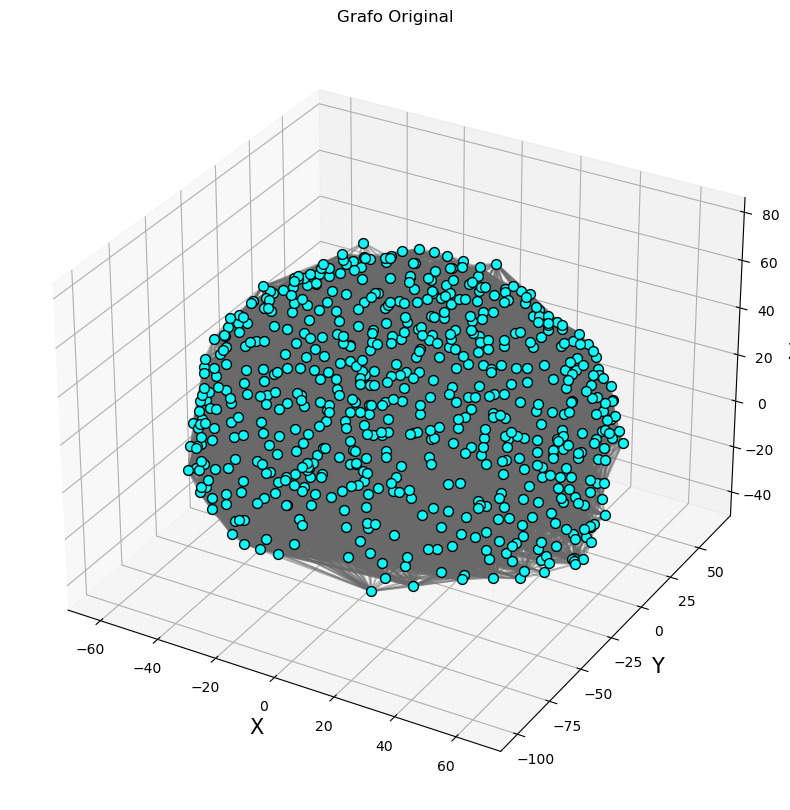

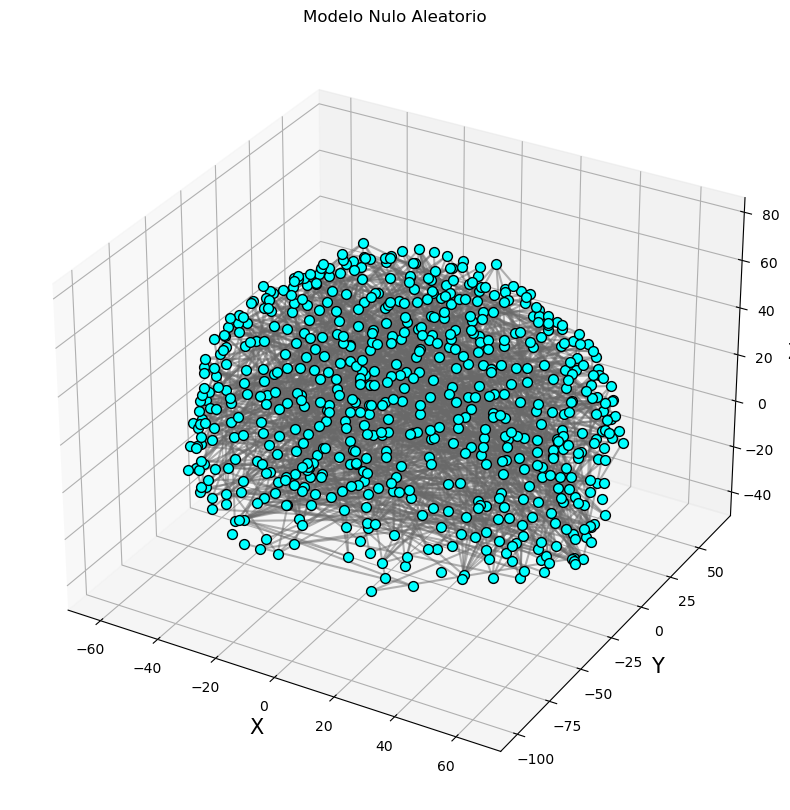

In [79]:
# BUENO NUEVE 
 # 9) Generar un modelo nulo aleatorio donde se tenga el mismo número de nodos y el mismo número total de conexiones, y comparar sus propiedades con el grafo original del cerebro.
path = r"/Users/sabrina/Documents/UNI/A-NEUROCIENCIAS/QUINTO /MODELOS/Neurociencias-2025-1/BCT/BCT/2019_03_03_BCT/data_and_demos/Coactivation_matrix.mat"
data = scipy.io.loadmat(path)
matrix = data['Coactivation_matrix']
coords = data['Coord']

x = coords[:, 0]
y = coords[:, 1]
z = coords[:, 2]

# modelo aleatorio 
num_nodos = matrix.shape[0]
num_aristas = np.sum(matrix) / 2  
p = (2 * num_aristas) / (num_nodos * (num_nodos - 1))
G_nulo = nx.erdos_renyi_graph(num_nodos, p)

# calcular propiedades original
def calcular_propiedades(G, nombre):
    propiedades = {}
    propiedades["Número de nodos"] = G.number_of_nodes()
    propiedades["Número de aristas"] = G.number_of_edges()
    
    grados = dict(G.degree()).values()
    propiedades["Grado promedio"] = sum(grados) / len(grados)
    
    propiedades["Coeficiente de clustering promedio"] = nx.average_clustering(G)
    
    propiedades["Coeficiente de mundo pequeño"] = nx.global_efficiency(G)
    
    cercania = list(nx.closeness_centrality(G).values())
    propiedades["Centralidad de cercanía promedio"] = np.mean(cercania)
    
    intermediacion = list(nx.betweenness_centrality(G).values())
    propiedades["Centralidad de intermediación promedio"] = np.mean(intermediacion)
    
    print(f"Propiedades del grafo {nombre}:")
    for key, value in propiedades.items():
        print(f"  {key}: {value}")
    print()
    return propiedades
propiedades_original = calcular_propiedades(nx.from_numpy_array(matrix), 'Original')

# propiedades aleatorio 
propiedades_nulo = calcular_propiedades(G_nulo, 'Modelo Nulo Aleatorio')

#ver los grafos 
def visualizar_grafo(G, titulo):
    figura = plt.figure(figsize=(10, 10))
    Ax = figura.add_subplot(111, projection='3d')
    
    for nodo in G.nodes():
        Ax.scatter(x[nodo], y[nodo], z[nodo], color='cyan', s=50, edgecolors="black")
    
    for edge in G.edges():
        node1, node2 = edge
        Ax.plot([x[node1], x[node2]], [y[node1], y[node2]], [z[node1], z[node2]], c='dimgray', alpha=0.5)
    
    Ax.set_title(titulo)
    Ax.set_xlabel("X", fontsize=15)
    Ax.set_ylabel("Y", fontsize=15)
    Ax.set_zlabel("Z", fontsize=15)
    plt.show()

visualizar_grafo(nx.from_numpy_array(matrix), 'Grafo Original')
visualizar_grafo(G_nulo, 'Modelo Nulo Aleatorio')



Propiedades del grafo Grafo Original:
  Número de nodos: 638
  Número de aristas: 18625
  Grado promedio: 58.38557993730407
  Coeficiente de clustering promedio: 0.3844533292242755
  Coeficiente de mundo pequeño: 0.49492420551600974
  Centralidad de cercanía promedio: 0.4547108341582646
  Centralidad de intermediación promedio: 0.0019101789247713589

Propiedades del grafo Modelo Nulo Aleatorio:
  Número de nodos: 638
  Número de aristas: 17259
  Grado promedio: 54.10344827586207
  Coeficiente de clustering promedio: 0.1406509270217059
  Coeficiente de mundo pequeño: 0.532054152744018
  Centralidad de cercanía promedio: 0.5073548079030763
  Centralidad de intermediación promedio: 0.0015365246334667286



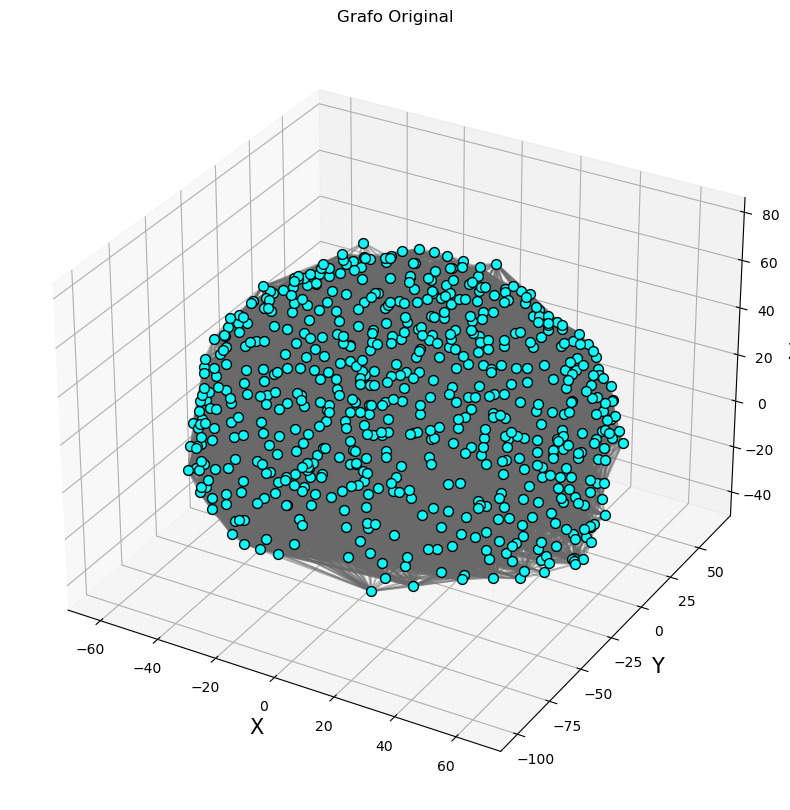

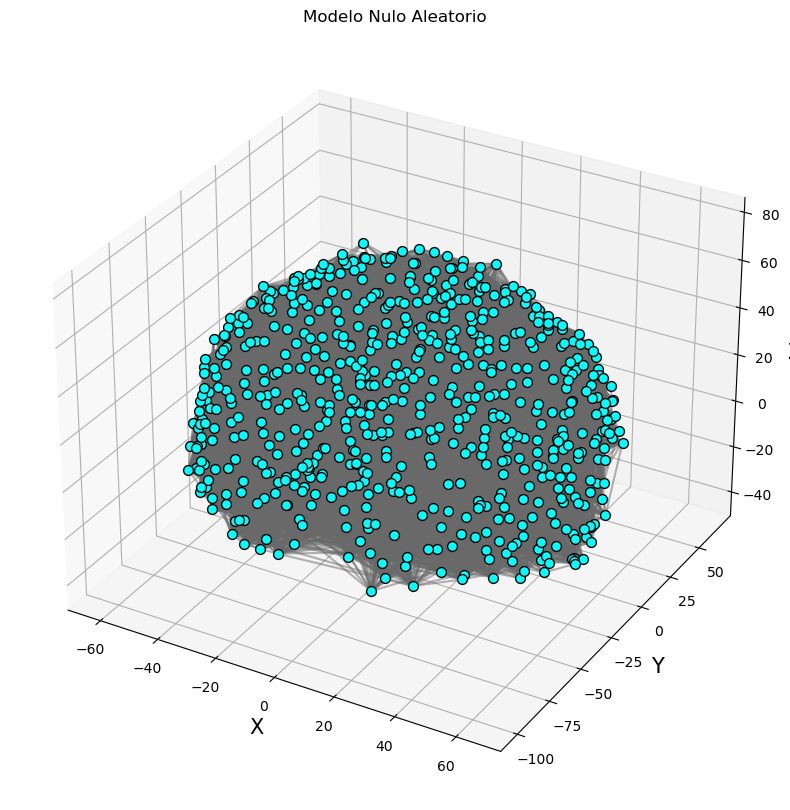

In [83]:
# 10) Generar un modelo nulo aleatorio donde se conserve la distribución de grado y comparar sus propiedades con el grafo original del cerebro.
path = r"/Users/sabrina/Documents/UNI/A-NEUROCIENCIAS/QUINTO /MODELOS/Neurociencias-2025-1/BCT/BCT/2019_03_03_BCT/data_and_demos/Coactivation_matrix.mat"
data = scipy.io.loadmat(path)
matrix = data['Coactivation_matrix']
coords = data['Coord']
x = coords[:, 0]
y = coords[:, 1]
z = coords[:, 2]

#modelo nulo aleatorio 
num_nodos = matrix.shape[0]
num_aristas = np.sum(matrix) / 2  

G = nx.from_numpy_matrix(matrix)

# generamos el modelo nulo aleatorio usando el Configuration Model
G_nulo = nx.configuration_model([degree for node, degree in G.degree()])
G_nulo_simple = nx.Graph(G_nulo)

#calcular propiedades 
def calcular_propiedades(G, nombre):
    propiedades = {}
    propiedades["Número de nodos"] = G.number_of_nodes()
    propiedades["Número de aristas"] = G.number_of_edges()
    
    grados = dict(G.degree()).values()
    propiedades["Grado promedio"] = sum(grados) / len(grados)
    
    propiedades["Coeficiente de clustering promedio"] = nx.average_clustering(G)
    
    propiedades["Coeficiente de mundo pequeño"] = nx.global_efficiency(G)
    
    cercania = list(nx.closeness_centrality(G).values())
    propiedades["Centralidad de cercanía promedio"] = np.mean(cercania)
    
    intermediacion = list(nx.betweenness_centrality(G).values())
    propiedades["Centralidad de intermediación promedio"] = np.mean(intermediacion)
    
    print(f"Propiedades del grafo {nombre}:")
    for key, value in propiedades.items():
        print(f"  {key}: {value}")
    print()
    return propiedades

# propiedades del grafo original
propiedades_original = calcular_propiedades(G, 'Grafo Original')

# propiedades del modelo nulo aleatorio
propiedades_nulo = calcular_propiedades(G_nulo_simple, 'Modelo Nulo Aleatorio')

#ver grafos 
def visualizar_grafo(G, titulo):
    figura = plt.figure(figsize=(10, 10))
    Ax = figura.add_subplot(111, projection='3d')
    
    for nodo in G.nodes():
        Ax.scatter(x[nodo], y[nodo], z[nodo], color='cyan', s=50, edgecolors="black")
    
    for edge in G.edges():
        node1, node2 = edge
        Ax.plot([x[node1], x[node2]], [y[node1], y[node2]], [z[node1], z[node2]], c='dimgray', alpha=0.5)
    
    Ax.set_title(titulo)
    Ax.set_xlabel("X", fontsize=15)
    Ax.set_ylabel("Y", fontsize=15)
    Ax.set_zlabel("Z", fontsize=15)
    plt.show()

visualizar_grafo(G, 'Grafo Original')
visualizar_grafo(G_nulo_simple, 'Modelo Nulo Aleatorio')



Propiedades del grafo Original:
  Número de nodos: 638
  Número de aristas: 18625
  Grado promedio: 58.38557993730407
  Coeficiente de clustering promedio: 0.3844533292242755
  Coeficiente de mundo pequeño: 0.49492420551600974
  Centralidad de cercanía promedio: 0.4547108341582646
  Centralidad de intermediación promedio: 0.0019101789247713589
Propiedades del grafo Modelo Nulo Geométrico:
  Número de nodos: 638
  Número de aristas: 3175
  Grado promedio: 9.952978056426332
  Coeficiente de clustering promedio: 0.01723978027077884
  Coeficiente de mundo pequeño: 0.3482586379131488
  Centralidad de cercanía promedio: 0.3280673242534038
  Centralidad de intermediación promedio: 0.003232407521839626


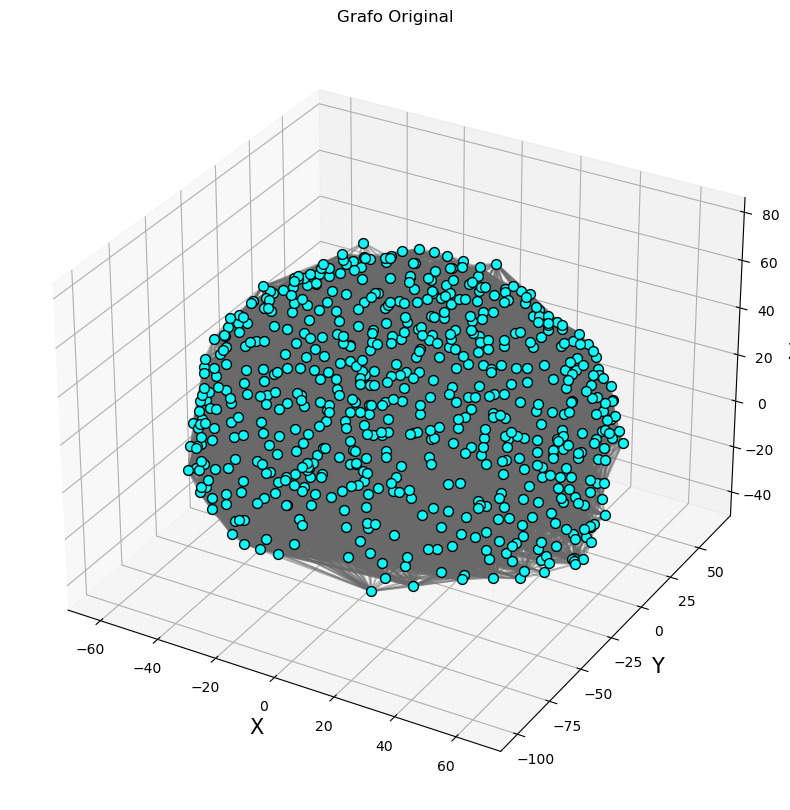

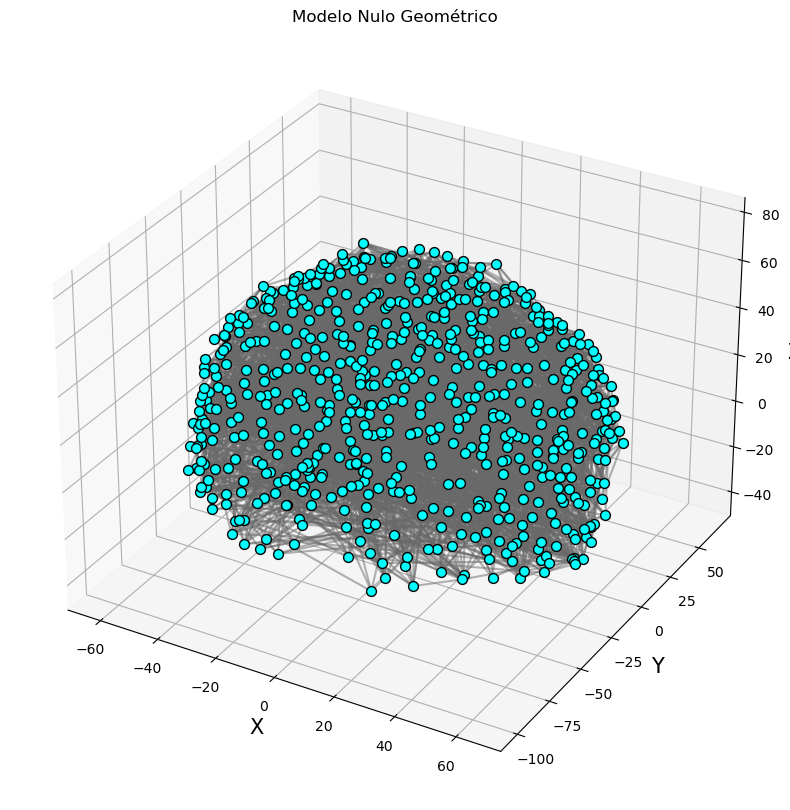


Las conexiones a larga distancia permiten la comunicación entre 
regiones cerebrales distantes para que trabajen de manera coordinada, 
facilitando tareas complejas como la percepción, toma de decisiones y memoria. 
El modelo nulo geométrico refleja cómo la probabilidad de conexión disminuye 
a medida que aumenta la distancia. 



In [87]:
# 11) Generar un modelo nulo utilizando una probabilidad de conexión en función de la distancia geométrica, con el mismo número de nodos y conexiones y compara sus propiedades y discutir la importancia de las conexiones a larga distancia en el cerebro.

#calcular distancia geométrica 
def distancia_geometrica(coords, i, j):
    return np.sqrt((coords[i, 0] - coords[j, 0]) ** 2 +
                   (coords[i, 1] - coords[j, 1]) ** 2 +
                   (coords[i, 2] - coords[j, 2]) ** 2)

# generar el modelo nulo utilizando la probabilidad de conexión inversamente proporcional a la distancia
def generar_grafo_nulo_geometrico(coords, umbral_probabilidad):
    num_nodos = len(coords)
    G_nulo = nx.Graph()

    for i in range(num_nodos):
        G_nulo.add_node(i, pos=coords[i])

    # establecer conexiones 
    for i in range(num_nodos):
        for j in range(i + 1, num_nodos):
            distancia = distancia_geometrica(coords, i, j)
            probabilidad = umbral_probabilidad / distancia

            if np.random.rand() < probabilidad:  # Si la probabilidad es mayor que un valor aleatorio
                G_nulo.add_edge(i, j)
                
    return G_nulo

umbral_probabilidad = 1.0  
G_nulo = generar_grafo_nulo_geometrico(coords, umbral_probabilidad)

#calcular propiedades 
def calcular_propiedades(G, nombre):
    propiedades = {}
    propiedades["Número de nodos"] = G.number_of_nodes()
    propiedades["Número de aristas"] = G.number_of_edges()
    
    grados = dict(G.degree()).values()
    propiedades["Grado promedio"] = sum(grados) / len(grados)
    
    propiedades["Coeficiente de clustering promedio"] = nx.average_clustering(G)
    
    propiedades["Coeficiente de mundo pequeño"] = nx.global_efficiency(G)
    
    cercania = list(nx.closeness_centrality(G).values())
    propiedades["Centralidad de cercanía promedio"] = np.mean(cercania)
    
    intermediacion = list(nx.betweenness_centrality(G).values())
    propiedades["Centralidad de intermediación promedio"] = np.mean(intermediacion)
    
    print(f"Propiedades del grafo {nombre}:")
    for key, value in propiedades.items():
        print(f"  {key}: {value}")
    return propiedades

# propiedades del grafo original
G = nx.from_numpy_matrix(matrix)  
propiedades_original = calcular_propiedades(G, 'Original')

# propiedades del modelo nulo geométrico
propiedades_nulo = calcular_propiedades(G_nulo, 'Modelo Nulo Geométrico')

#visualizar grafos 
def visualizar_grafo(G, coords, titulo):
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')
    
    for nodo in G.nodes():
        ax.scatter(coords[nodo, 0], coords[nodo, 1], coords[nodo, 2], color='cyan', s=50, edgecolors="black")
    
    for edge in G.edges():
        node1, node2 = edge
        ax.plot([coords[node1, 0], coords[node2, 0]], 
                [coords[node1, 1], coords[node2, 1]], 
                [coords[node1, 2], coords[node2, 2]], 
                c='dimgray', alpha=0.5)
    
    ax.set_title(titulo)
    ax.set_xlabel("X", fontsize=15)
    ax.set_ylabel("Y", fontsize=15)
    ax.set_zlabel("Z", fontsize=15)
    plt.show()

visualizar_grafo(G, coords, 'Grafo Original')
visualizar_grafo(G_nulo, coords, 'Modelo Nulo Geométrico')

print("""
Las conexiones a larga distancia permiten la comunicación entre 
regiones cerebrales distantes para que trabajen de manera coordinada, 
facilitando tareas complejas como la percepción, toma de decisiones y memoria. 
El modelo nulo geométrico refleja cómo la probabilidad de conexión disminuye 
a medida que aumenta la distancia. 
""")



In [89]:
# 12) Escribir una reseña de lo aprendido en el curso, incluyendo la importancia de conocer herramientas de teoría de grafos para comprender la conectividad del cerebro (mínimo 200 palabras).
print("""
A lo largo del curso aprendimos diversas herramientas y enfoques 
que nos permitieron explorar la conectividad cerebral a través 
de la teoría de grafos. Comenzamos por entender cómo crear un 
grafo y la importancia de que estos sean direccionados o no 
direccionados, ya que la información no se transmite de la misma 
manera en un solo sentido que en ambos. Posteriormente, 
analizamos las matrices de mono y gato, observando las diferencias 
entre ellas y sus conexiones. Pudimos evaluar diversas medidas 
como la longitud característica, los grados de entrada y salida, 
identificar hubs, realizar correlaciones y aleatorizar matrices. 
Todo ello nos permitió explorar las conexiones entre las diferentes 
áreas y cómo fluye la información entre ellas. Esto también podría 
ayudarnos a estudiar cómo las redes son resistentes a fallos o 
lesiones, y cómo su reorganización podría contribuir a la 
plasticidad cerebral. Finalmente este tipo de herramientas son 
cruciales para cualquier análisis de datos acerca de conexiones 
cerebrales, fue interesante aprender a hacerlo. 
""")



A lo largo del curso aprendimos diversas herramientas y enfoques 
que nos permitieron explorar la conectividad cerebral a través 
de la teoría de grafos. Comenzamos por entender cómo crear un 
grafo y la importancia de que estos sean direccionados o no 
direccionados, ya que la información no se transmite de la misma 
manera en un solo sentido que en ambos. Posteriormente, 
analizamos las matrices de mono y gato, observando las diferencias 
entre ellas y sus conexiones. Pudimos evaluar diversas medidas 
como la longitud característica, los grados de entrada y salida, 
identificar hubs, realizar correlaciones y aleatorizar matrices. 
Todo ello nos permitió explorar las conexiones entre las diferentes 
áreas y cómo fluye la información entre ellas. Esto también podría 
ayudarnos a estudiar cómo las redes son resistentes a fallos o 
lesiones, y cómo su reorganización podría contribuir a la 
plasticidad cerebral. Finalmente este tipo de herramientas son 
cruciales para cualquier análisis 